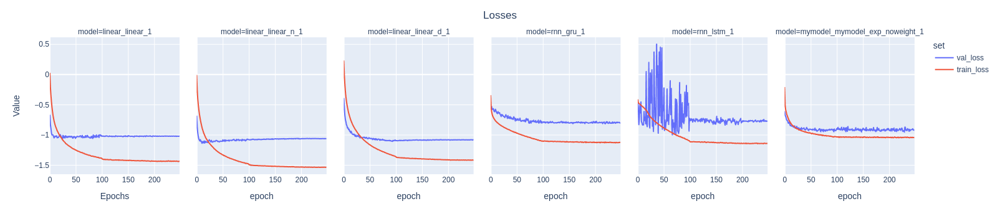

In [1]:
import plotly.express as px
import pandas as pd
tot_losses = pd.read_csv('/home/agobbi/Projects/ExpTS/edison/edison/csv/prova_test_LOSSES.csv')

fig_losses = px.line(tot_losses,x = 'epoch',y='loss',color = 'set',facet_col='model',width = 2600)
#fig_losses.update_traces(mode="markers+lines", hovertemplate=None)
#fig_losses.update_layout(hovermode="x unified")
fig_losses.update_layout(title = {'text':f'Losses', 'x':0.5},
                  xaxis_title={'text':'Epochs'},
                  yaxis_title={'text':'Value'},

                    )
    
fig_losses

In [2]:
tot_losses.model.unique()

array(['linear_linear_1', 'linear_linear_n_1', 'linear_linear_d_1',
       'rnn_gru_1', 'rnn_lstm_1', 'mymodel_mymodel_exp_noweight_1'],
      dtype=object)

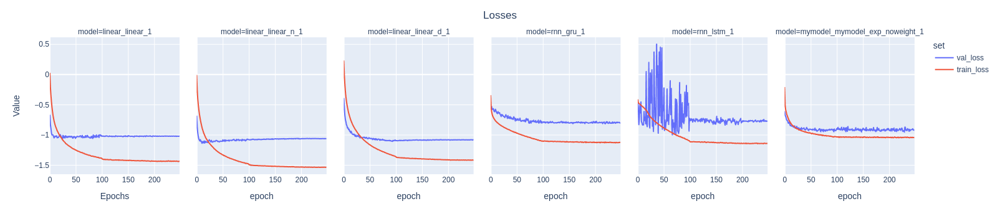

In [4]:
import plotly.express as px
import pandas as pd
tot_losses = pd.read_csv('/home/agobbi/Projects/ExpTS/edison/edison/csv/prova_test_LOSSES.csv')

fig_losses = px.line(tot_losses,x = 'epoch',y='loss',color = 'set',facet_col='model',width = 2600)
#fig_losses.update_traces(mode="markers+lines", hovertemplate=None)
#fig_losses.update_layout(hovermode="x unified")
fig_losses.update_layout(title = {'text':f'Losses', 'x':0.5},
                  xaxis_title={'text':'Epochs'},
                  yaxis_title={'text':'Value'},

                    )
    
fig_losses

In [5]:
import plotly.express as px
import pandas as pd
tot_pred = pd.read_csv('/home/agobbi/Projects/ExpTS/edison/edison/csv/prova_test_tot_predictions.csv')
tot_pred.sort_values(by='time',inplace=True)
#tot_pred.y_median[tot_pred.model=='d3vae_weather_1'] = tot_pred.y_pred[tot_pred.model=='d3vae_weather_1']
#tot_pred.y_median[tot_pred.model=='persistent_weather_1'] = tot_pred.y_pred[tot_pred.model=='persistent_weather_1']

In [6]:
tot_pred.model.unique()

array(['linear_linear_1', 'rnn_gru_1', 'linear_linear_d_1',
       'mymodel_mymodel_exp_noweight_1', 'rnn_lstm_1',
       'persistent_persistent_1', 'linear_linear_n_1'], dtype=object)

In [13]:
import numpy as np
tot_pred.loc[np.isnan(tot_pred.y_pred),'y_pred']  = tot_pred.y_median[np.isnan(tot_pred.y_pred)] 

AttributeError: 'DataFrame' object has no attribute 'y_median'

In [7]:
tot_pred.head()

,Unnamed: 0,lag,time,y,y_pred,model
0,0,1,2021-03-13 04:00:00,2876.975,3129.8198,linear_linear_1
1990300,1990300,1,2021-03-13 04:00:00,2876.975,3194.6956,rnn_gru_1
1492725,1492725,1,2021-03-13 04:00:00,2876.975,3144.3400,linear_linear_d_1
2985450,2985450,1,2021-03-13 04:00:00,2876.975,3299.9204,mymodel_mymodel_exp_noweight_1
2487875,2487875,1,2021-03-13 04:00:00,2876.975,3367.9014,rnn_lstm_1


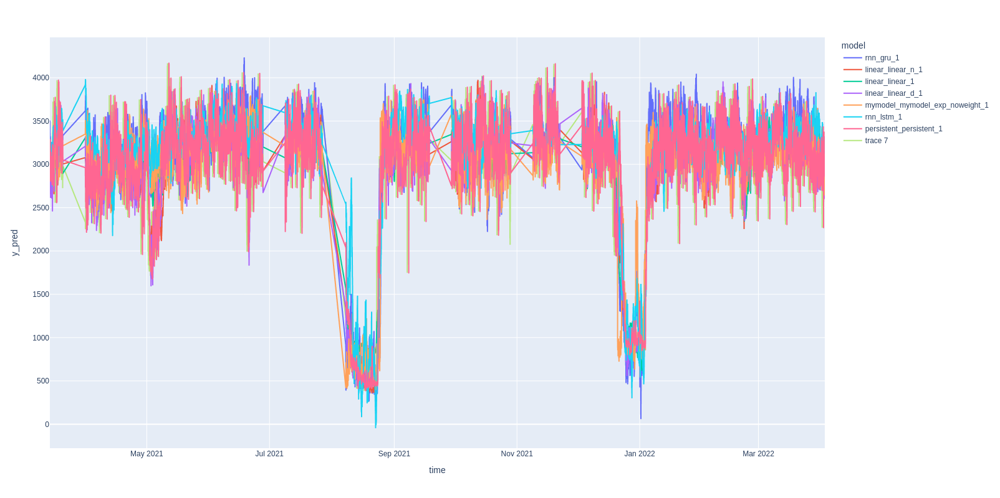

In [8]:
lag=17
fig = px.line(tot_pred[(tot_pred.lag==lag)], x='time', y='y_pred', color='model',height=800)
fig.add_scatter(x = tot_pred[tot_pred.lag==lag].time, y=tot_pred[tot_pred.lag==lag].y)


In [9]:
tot_pred = tot_pred[tot_pred.y>1800]

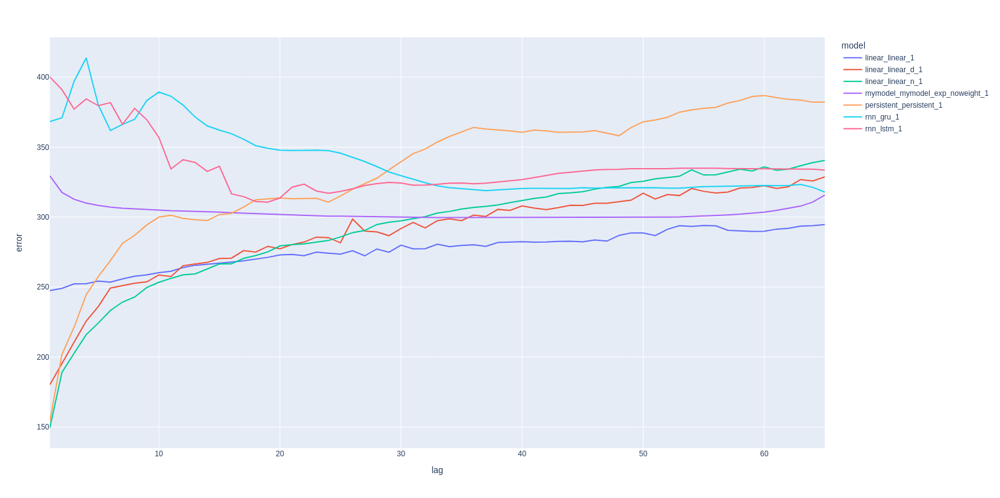

In [10]:
import numpy as np
error = tot_pred.groupby(['lag','model']).apply(lambda x: np.nanmean(np.abs(x.y-x.y_pred))).reset_index().rename(columns={0:'error'}) 
fig = px.line(error, x='lag', y='error', color='model',height=800)
fig.show() #150--400

In [83]:
error[error.model=='tft_tft_1'] 5.597011 -- 9.694332 

SyntaxError: invalid syntax (1586231523.py, line 1)

In [ ]:
error[error.model=='mymodel_mymodel_1'] #8.668818 -- 11.640426 

In [14]:
error[error.model=='mymodel_mymodel_1'] #10.243987 -- 13.429317

,lag,model,error
3,1,mymodel_mymodel_1,321.610529
8,2,mymodel_mymodel_1,320.955907
13,3,mymodel_mymodel_1,321.410525
18,4,mymodel_mymodel_1,321.666914
23,5,mymodel_mymodel_1,321.858690
...,...,...,...
303,61,mymodel_mymodel_1,317.904804
308,62,mymodel_mymodel_1,317.912733
313,63,mymodel_mymodel_1,317.863449
318,64,mymodel_mymodel_1,319.214497


In [1]:
from datetime import timedelta
import plotly.express as px
import pandas as pd
tot_pred = pd.read_csv('/home/agobbi/Projects/ExpTS/edison/edison/csv/prova_test_tot_predictions.csv')
tot_pred.sort_values(by='time',inplace=True)
tot_pred.time = pd.to_datetime(tot_pred.time)
tot_pred['prediction_time'] = tot_pred.apply(lambda x: x.time-timedelta(hours=x.lag), axis=1)

In [2]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(tot_pred[(tot_pred.model=='linear_linear_1') &(tot_pred.lag==1)].y.values.reshape(-1,1));

In [3]:
persistence = tot_pred[tot_pred.lag==1]
persistence.time = persistence.time.apply(lambda x:x+timedelta(hours=2))
persistence = persistence[['time','model','y']].rename(columns={'y':'y_prec'})
tot_pred = pd.merge(tot_pred,persistence)

/tmp/ipykernel_370707/2895413657.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  persistence.time = persistence.time.apply(lambda x:x+timedelta(hours=2))


In [5]:
tot_pred.y = scaler.transform(tot_pred.y.values.reshape(-1,1)).flatten()
tot_pred.y_pred = scaler.transform(tot_pred.y_pred.values.reshape(-1,1)).flatten()
tot_pred.y_prec = scaler.transform(tot_pred.y_prec.values.reshape(-1,1)).flatten()


In [6]:
tot_pred.model.unique()

array(['persistent_persistent_1', 'mymodel_mymodel_exp_noweight_1',
       'rnn_gru_1', 'linear_linear_n_1', 'rnn_lstm_1', 'linear_linear_1',
       'linear_linear_d_1'], dtype=object)

In [7]:
date  ='2021-03-17 03:00:00'
aa = tot_pred[(tot_pred.prediction_time==date)&(tot_pred.model=='linear_linear_1')]
bb = tot_pred[(tot_pred.prediction_time==date)&(tot_pred.model=='mymodel_mymodel_exp_noweight_1')]

In [8]:
tot_pred.model.unique()

array(['persistent_persistent_1', 'mymodel_mymodel_exp_noweight_1',
       'rnn_gru_1', 'linear_linear_n_1', 'rnn_lstm_1', 'linear_linear_1',
       'linear_linear_d_1'], dtype=object)

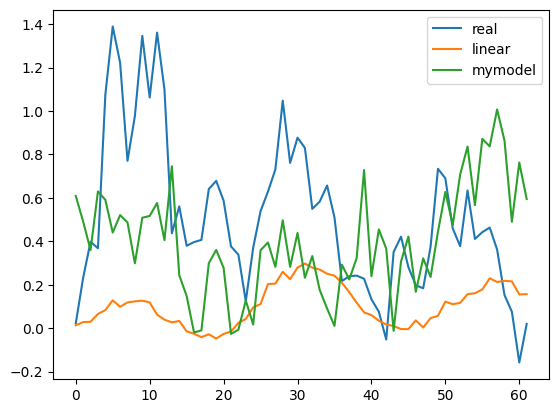

In [9]:
import matplotlib.pyplot as plt
plt.plot(aa.y.values,label='real')
plt.plot(aa.y_pred.values,label='linear')
plt.plot(bb.y_pred.values,label='mymodel')
plt.legend()

In [13]:
import numpy as np
def compute(x,alpha=1):

    try:
        prec = x.y_prec[x.lag==1].values[0]
    except:
        return None, [None], None, None, None, None, None
    persistence = np.mean(np.abs(x.y.values-prec))
    error = np.abs(x.y.values-x.y_pred.values)
    scost = np.abs(prec-x.y_pred.values)
    persistence_w = (np.exp(-alpha*np.abs(prec-x.y_pred.values)))
    error_per_lag = error*persistence_w
    tot_error = np.mean(error_per_lag)
    return persistence, error, persistence_w,tot_error,np.mean(error),scost, error_per_lag

In [14]:
def compute_fun(x):
    persistence, error, persistence_w,tot_error,_,scost,error_per_lag = compute(x)
    return pd.Series({'peristence':persistence if persistence is not None else np.nan, 
                      'l1':np.mean(error) if persistence is not None else np.nan,
                      'persistence_w':np.mean(persistence_w) if persistence is not None else np.nan,
                      'error':tot_error if persistence is not None else np.nan,
                      'scost':np.mean(scost) if persistence is not None else np.nan})

In [15]:
persistence_m, error_m, persistence_w_m,tot_error_m,percentage_m,scost_pers_m,error_per_lag_m = compute(bb,20.1)
persistence_l, error_l, persistence_w_l,tot_error_l,percentage_l,scost_pers_l,error_per_lag_l = compute(aa,20.1)

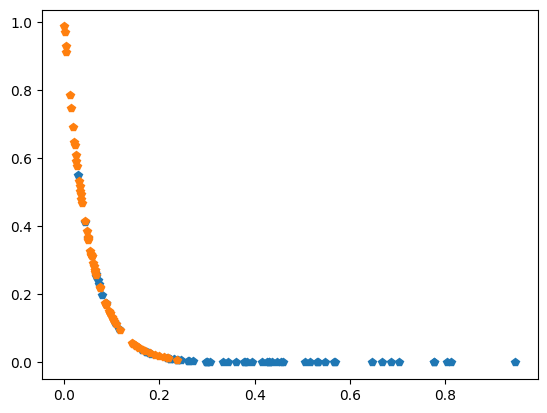

In [16]:
plt.plot(scost_pers_m,persistence_w_m,'p')
plt.plot(scost_pers_l,persistence_w_l,'p')

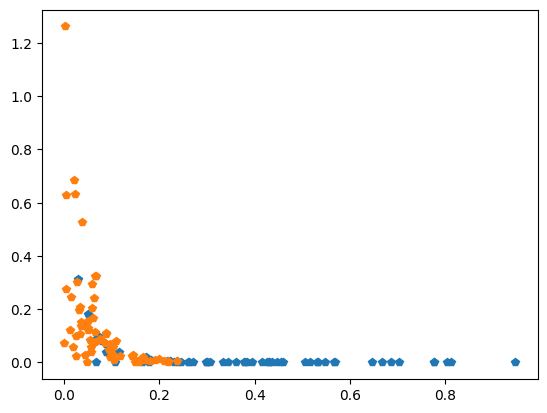

In [17]:
plt.plot(scost_pers_m,error_per_lag_m,'p')
plt.plot(scost_pers_l,error_per_lag_l,'p')

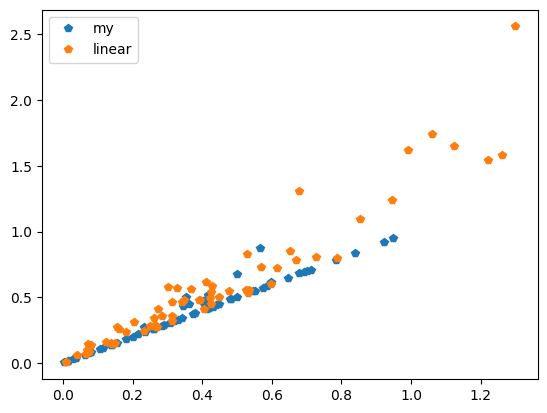

In [18]:
persistence_m, error_m, persistence_w_m,tot_error_m,percentage_m,scost_pers_m,error_per_lag_m = compute(bb,20.1)
persistence_l, error_l, persistence_w_l,tot_error_l,percentage_l,scost_pers_l,error_per_lag_l = compute(aa,20.1)
plt.plot(error_m,error_per_lag_m+error_m,'p',label='my')
plt.plot(error_l,error_per_lag_l+error_l,'p',label='linear')
plt.legend()

In [19]:
print(tot_error_m-tot_error_l)
print(percentage_m-percentage_l)

-0.12639985690613076
-0.059474578491127805


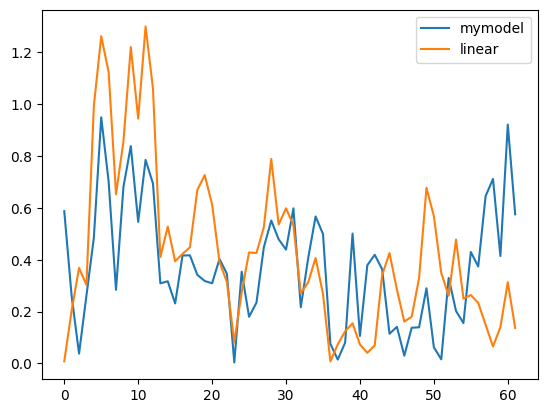

In [20]:
plt.plot(error_m,label = 'mymodel')
plt.plot(error_l,label = 'linear')
plt.legend()

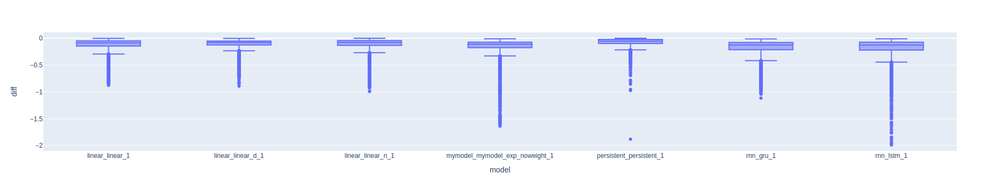

In [118]:
agg = tot_pred.groupby(['prediction_time','model']).apply(compute_fun).reset_index().dropna()
agg['diff'] = agg.error-agg.l1
px.box(agg, x='model',y='diff')

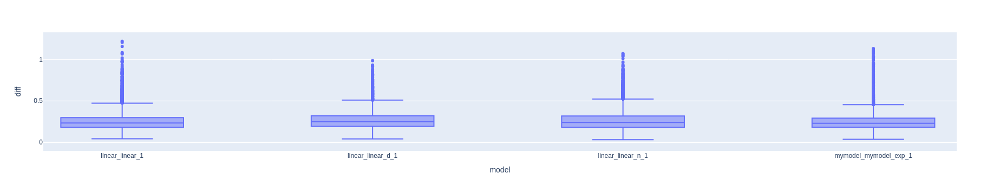

In [42]:
def compute_fun2(x,alpha=20):
    #print(alpha)
    persistence, error, persistence_w,tot_error,_,scost,error_per_lag = compute(x,alpha)
    res = {}
    if error_per_lag is not None:
        for i in range(len(error_per_lag)):
            res[i+1] = error_per_lag[i]
        return pd.Series(res)
agg2 = tot_pred.groupby(['prediction_time','model']).apply(compute_fun2,alpha=0.00001).reset_index().dropna()

In [43]:
res = agg2.groupby(['model','level_2'])[0].mean()

In [44]:
res.reset_index()

,model,level_2,0
0,linear_linear_1,1,0.335857
1,linear_linear_1,2,0.337007
2,linear_linear_1,3,0.340169
3,linear_linear_1,4,0.339165
4,linear_linear_1,5,0.342000
...,...,...,...
450,rnn_lstm_1,61,0.453015
451,rnn_lstm_1,62,0.452819
452,rnn_lstm_1,63,0.453084
453,rnn_lstm_1,64,0.453555


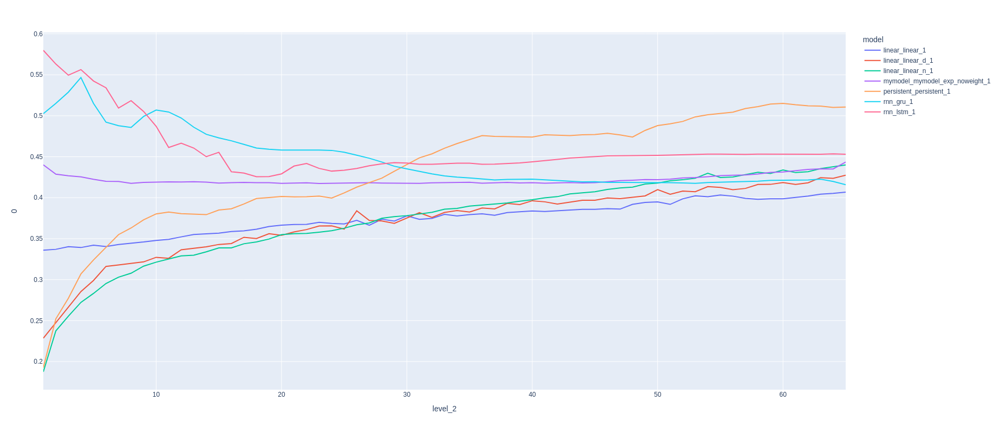

In [45]:
import numpy as np
fig = px.line(res.reset_index(), x='level_2', y=0, color='model',height=800)
fig.show() #150--400

In [ ]:
agg2 = tot_pred.groupby(['prediction_time','model']).apply(compute_fun2).reset_index().dropna()


In [ ]:
agg['diff'] = agg.error-agg.l1
px.box(agg, x='model',y='diff')